## This notebook is meant for calculating essential for the Radio Array (RAY)##

In [29]:
import numpy as  np
import matplotlib.pyplot as plt
import pandas as pd
import chardet
import csv

## Task - 1 RFI Estimation ##

In [ ]:
filepath='/media/rohit/data/Dropbox/projects/RAY/'
filename='RFI_SURVEY_20250724T060503_50MHz_2000MHz_751.csv'

df = pd.read_csv(filepath+filename,encoding='ISO-8859-1')
#with open(filepath+filename, 'rb') as f:
#    result = chardet.detect(f.read())
#df = pd.read_csv(filepath+filename, encoding=result['encoding'])

UnicodeDecodeError: 'utf-8' codec can't decode byte 0x8a in position 0: invalid start byte

In [28]:
with open(filepath+filename, "rb") as f:
    result = chardet.detect(f.read())
    print(result)

{'encoding': None, 'confidence': 0.0, 'language': None}


In [60]:
import csv

with open(filepath + filename, mode='r', encoding='ISO-8859-1', errors='ignore') as file:
    # Remove null bytes from each line before passing to DictReader
    clean_lines = (line.replace('\x00', '') for line in file)
    csv_reader = csv.DictReader(clean_lines)
    
    for row in csv_reader:
        print(row)

{'\x8aUµ½V³P1\x80': 'ä{\x8ekúPý\x96´Èâð0\x85®dF{hYV5Ü\t*\x0b\x0c\x921ÉÇáé^\x1f\x16Ïþ\x12¬\x9e¬ó2wÿ\x0bV\x8eº3Ó|i\x1c\x9fÚV0D7y\x92l (', None: ['À\x1c\x91\x9fÀþ¾\x95÷oÀûe\x8bÃÚV#hÂD¨á\x8f\x079\x1d?\x0eõøÎc\x08ýENûî~\x85\x87j8¸Jhä?iû\x99lü1©-»', '\x88aie\x90\x8e\x15v\x9e?/óÖ¿\x89oÚ\x12Xu\x1f\x8aþ4{6óÙuÙÍÔ\x91)']}
{'\x8aUµ½V³P1\x80': 'ò\x8aTrzc\x07é_Mà_4¸ï\x10Ó÷T\x0eo\x12£\x19p\x959Åèê/Èò©¯!\x10I\x1aH^XÐI\x14\x8c\x08;º\x11\x8aåYD\trl_ý!þw\x85¹Pr2+ûo\x0c¬\x95¿\xadÏçZô\x13\x8e\x8c\x8e\x19Vá¿y\x8f1\x89\x89\x80à\x06\x15#K'}
{'\x8aUµ½V³P1\x80': "\x02Ó¶Æ\x89¶\x80\x062O\x1f¥z\x8bcÍ\x97ºÚlÉ\x9e8îamþj§\x9avÈ\x1b;\x86y\x14Ë\x81åG#ÊD\x96èÊ¨«\x8dÜ\x8e\x05;ÙÜÆ×³±L/\x9fj\x8c¤\x86~6ÈH\x0b\x16yÏ¡ëþMi46\x96®ðÀ\x0c\x81v²Èy'=¨sm.fi"}
{'\x8aUµ½V³P1\x80': 'rÖÈ´öâh\x9a\x7f\x99Ü\x0c \x8cpTzûóúU\tC¬\x90Ì±²Û\x85Ú@ld\x8e§óô®zÑÕ;\x9bFo\x95«\x16\x98=Ð\x91e\x98;DÀ\x15\x95ðJö\x15s[\x92I¥³\x89V8B[\x80\x871YòIlÃ\x9d4\x93FlM\x1d±\x92emÒÎá%2r¸Æ23Çÿª\xa0ù\x93dûC<`Æ¼\x18\x9e3\x8fÖ¦W¾¥G\x97\x97A³É!7¼i\x10\x88ìß\x80Å{×<fym\xa

KeyboardInterrupt: 

In [62]:
import pandas as pd
df = pd.read_pickle(filepath+'/RFI_SURVEY_20250724T060503_50MHz_2000MHz_751.pkl')

UnpicklingError: invalid load key, '\xd1'.

In [ ]:
import pickle
import gzip

import os
import pickle
import numpy as np
import re


file_path = filepath + '/RFI_SURVEY_20250724T060503_50MHz_2000MHz_751.txt'
import pandas as pd
import numpy as np

file_path = filepath + '/test-rfi.txt.txt'

import numpy as np

file_path = filepath + '/test-rfi.txt.txt'

valid_rows = []

with open(file_path, 'r', encoding='ISO-8859-1') as f:
    for line in f:
        print(len(line))
        values = line.strip().split(',')
        try:
            row = [float(val) for val in values]
            print(row)
            valid_rows.append(row)
        except ValueError:
            # Skip rows with non-numeric entries
            continue

# Convert to 2D NumPy array
data_array = np.array(valid_rows, dtype=np.float32)

print("✅ Final 2D array shape:", data_array.shape)




ValueError: binary mode doesn't take an encoding argument

(113,)
751 is not a factor of total length.


TypeError: Invalid shape (25091989,) for image data

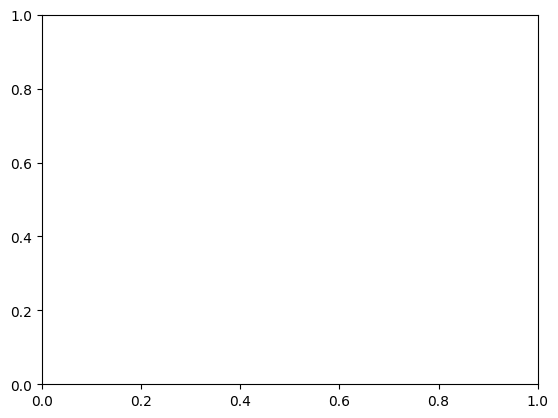

In [92]:
df_arr = df.to_numpy()
print(df_arr[0].shape)


data=data[0:50183322]
freq_bins = 751
total = len(data)
time_steps = total // freq_bins  # should be integer

if total % freq_bins == 0:
    data = data.reshape((time_steps, freq_bins))
    print(f"Reshaped to: ({time_steps}, {freq_bins})")
else:
    print("751 is not a factor of total length.")

plt.imshow(data, aspect='auto', origin='lower', cmap='viridis')
plt.colorbar(label='Signal')
plt.xlabel('Frequency bin')
plt.ylabel('Time index')
plt.title('RFI Survey Data')
plt.show()